In [1]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf
from PIL import Image
import os
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
import pathlib
import random
import matplotlib.image as mpimg

2024-02-06 12:45:28.345607: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-02-06 12:45:28.349438: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-02-06 12:45:28.401199: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-06 12:45:28.401253: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-06 12:45:28.402674: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to

In [2]:
data_dir = '/home/meriem-mk/Downloads/food101/food-101/food-101/images'
data_dir = pathlib.Path(data_dir).with_suffix('')

In [8]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

101000


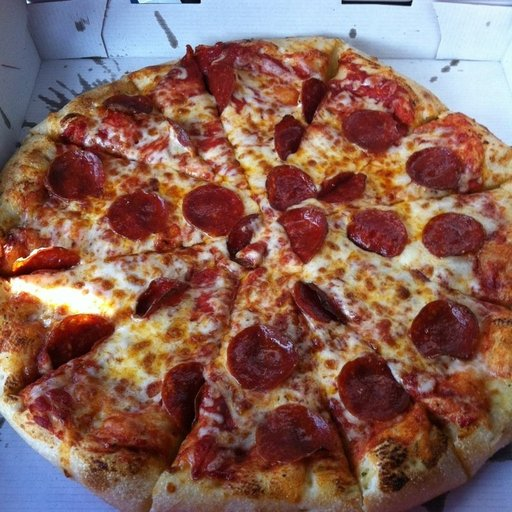

In [9]:
pizza = list(data_dir.glob('pizza/*'))
PIL.Image.open(str(pizza[0]))

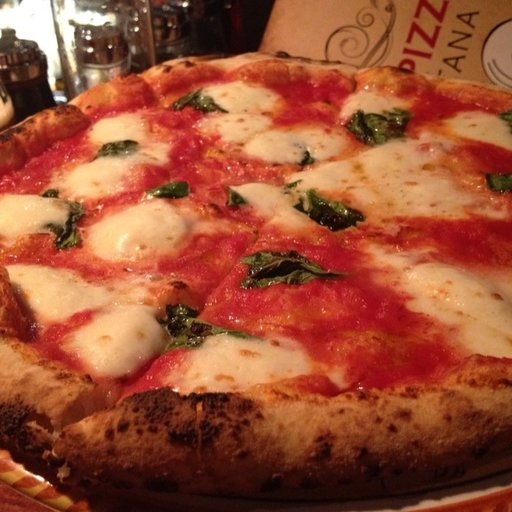

In [12]:
PIL.Image.open(str(pizza[10]))

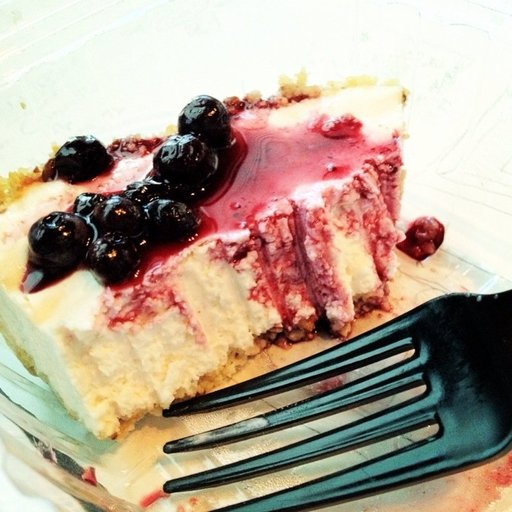

In [13]:
cheesecake = list(data_dir.glob('cheesecake/*'))
PIL.Image.open(str(cheesecake[0]))

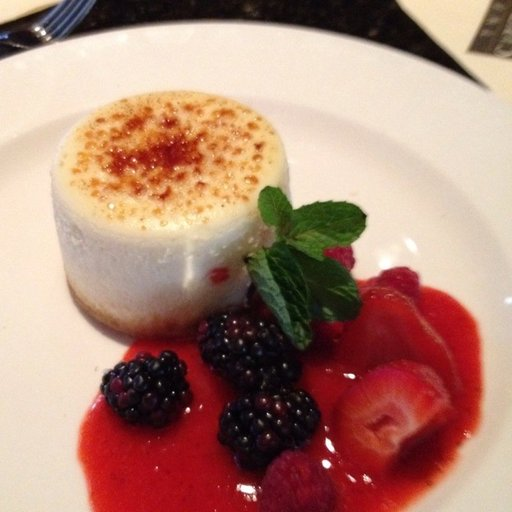

In [14]:
PIL.Image.open(str(cheesecake[3]))

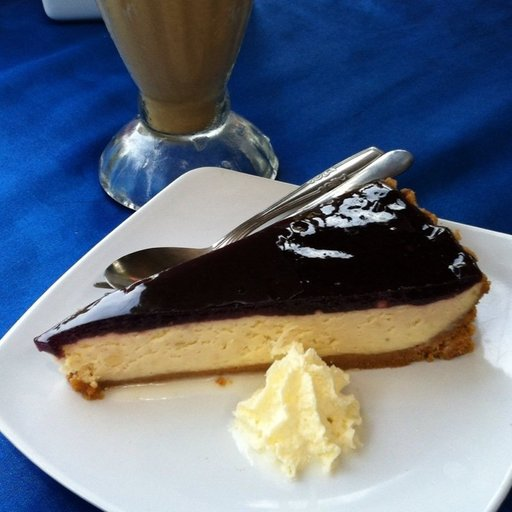

In [18]:
PIL.Image.open(str(cheesecake[99]))

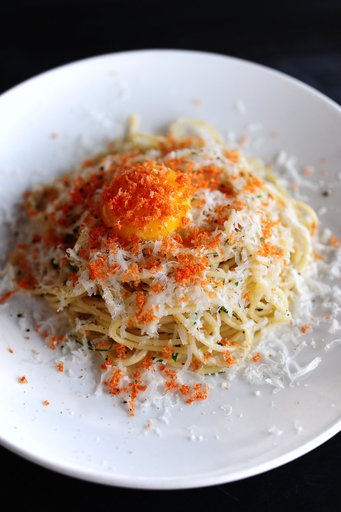

In [61]:
spaghetti = list(data_dir.glob('spaghetti_carbonara/*'))
PIL.Image.open(str(spaghetti[2]))

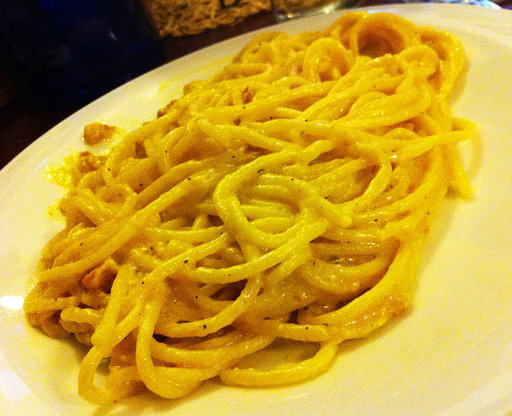

In [65]:
PIL.Image.open(str(spaghetti[15]))

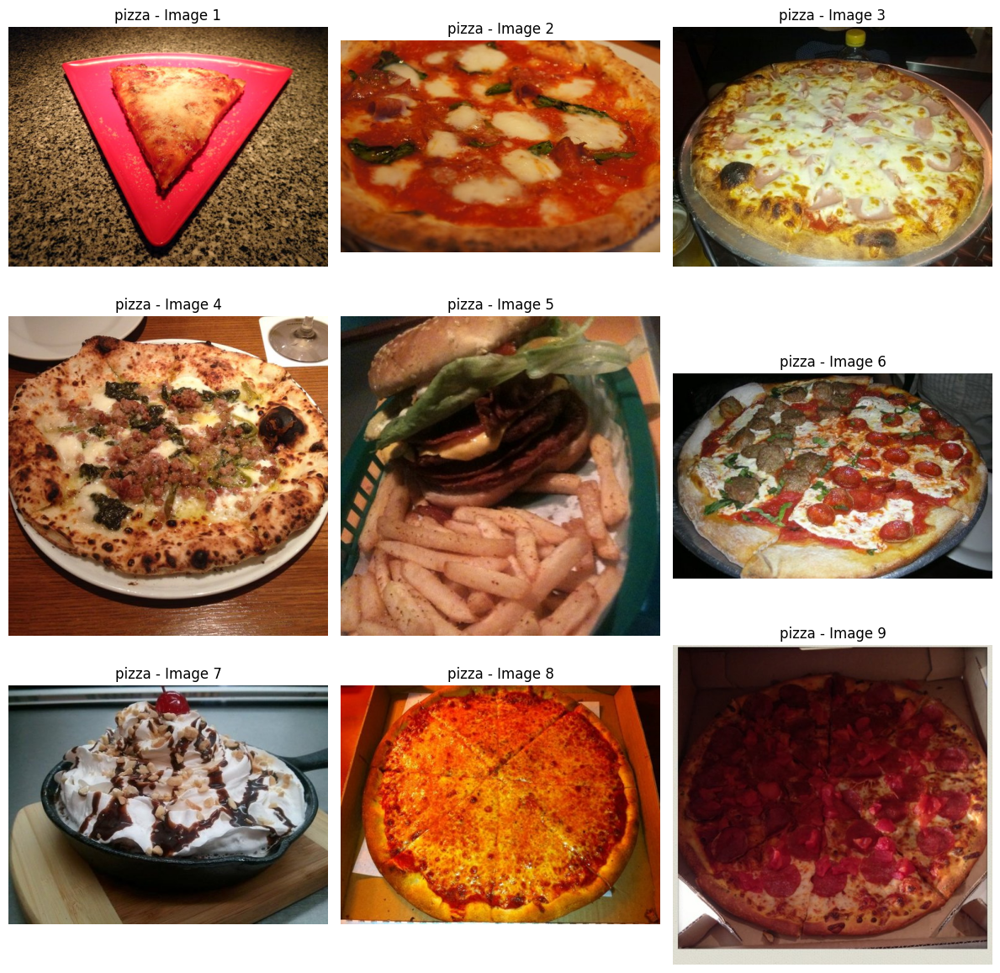

In [11]:
def display_random_images(dataset_path, class_name, num_images=9):
    class_path = os.path.join(dataset_path, class_name)
    image_files = os.listdir(class_path)
    
    random_images = random.sample(image_files, min(num_images, len(image_files)))

    plt.figure(figsize=(12, 12))
    for i, image_file in enumerate(random_images):
        img_path = os.path.join(class_path, image_file)
        plt.subplot(3, 3, i + 1)
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.title(f'{class_name} - Image {i + 1}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


display_random_images(data_dir, 'pizza', num_images=9)


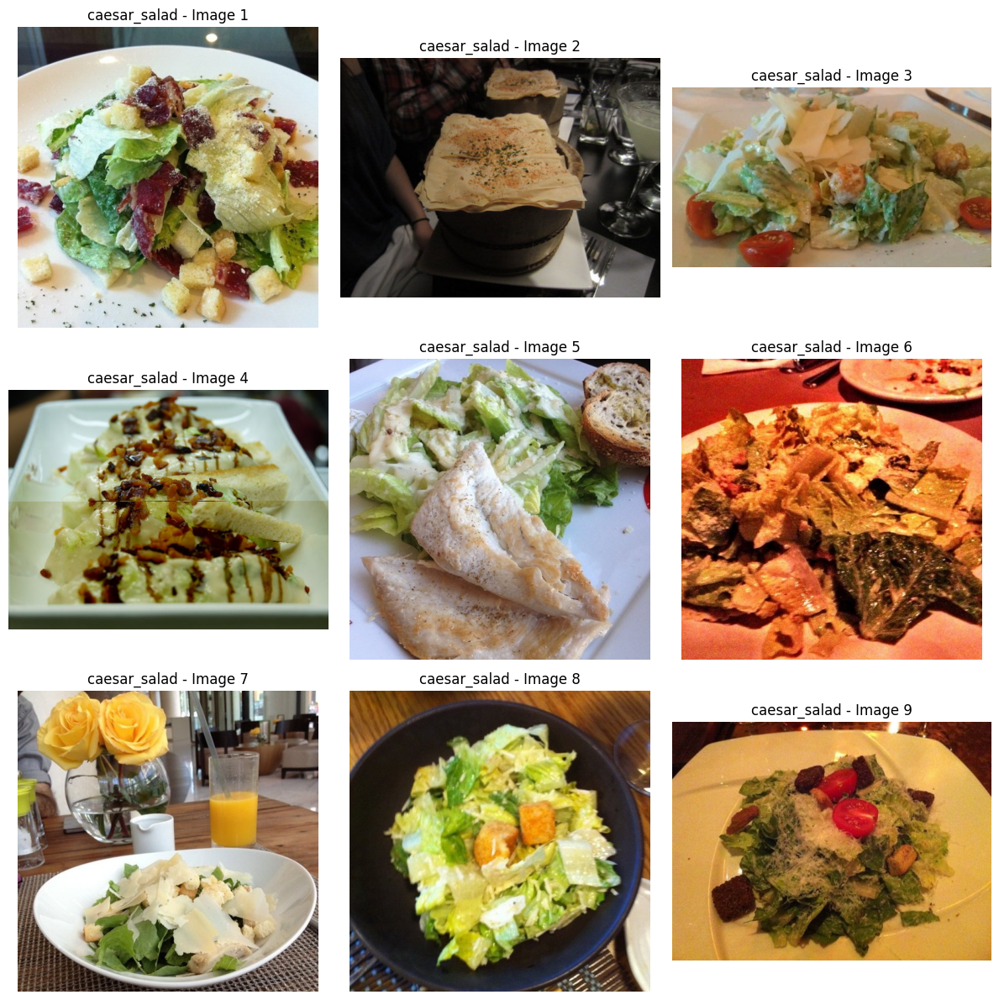

In [100]:
display_random_images(dataset_dir, 'caesar_salad', num_images=9)

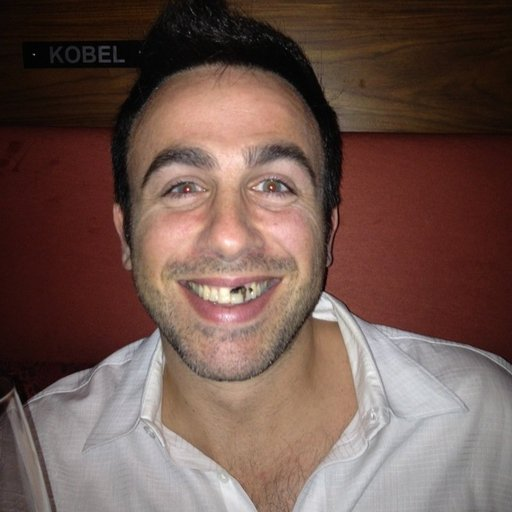

In [119]:
PIL.Image.open(str(data_dir)+'/caesar_salad/1303023.jpg')

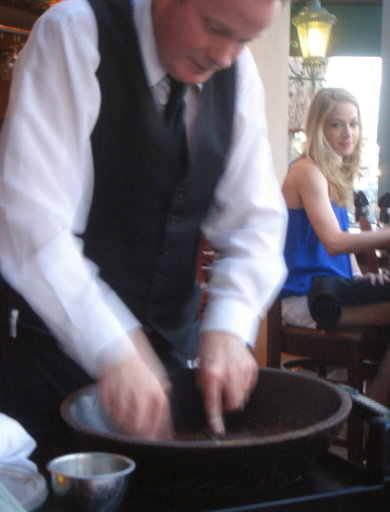

In [120]:
PIL.Image.open(str(data_dir)+'/caesar_salad/1994771.jpg')

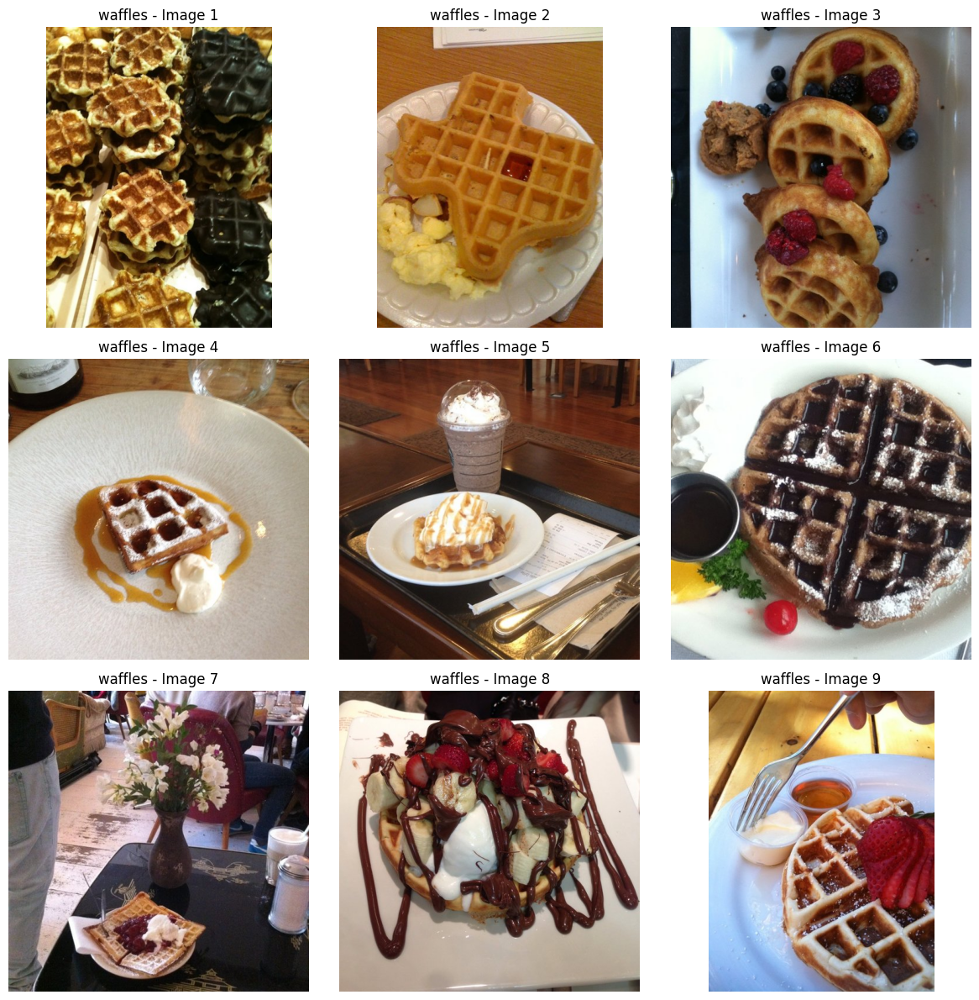

In [121]:
display_random_images(dataset_dir, 'waffles', num_images=9)

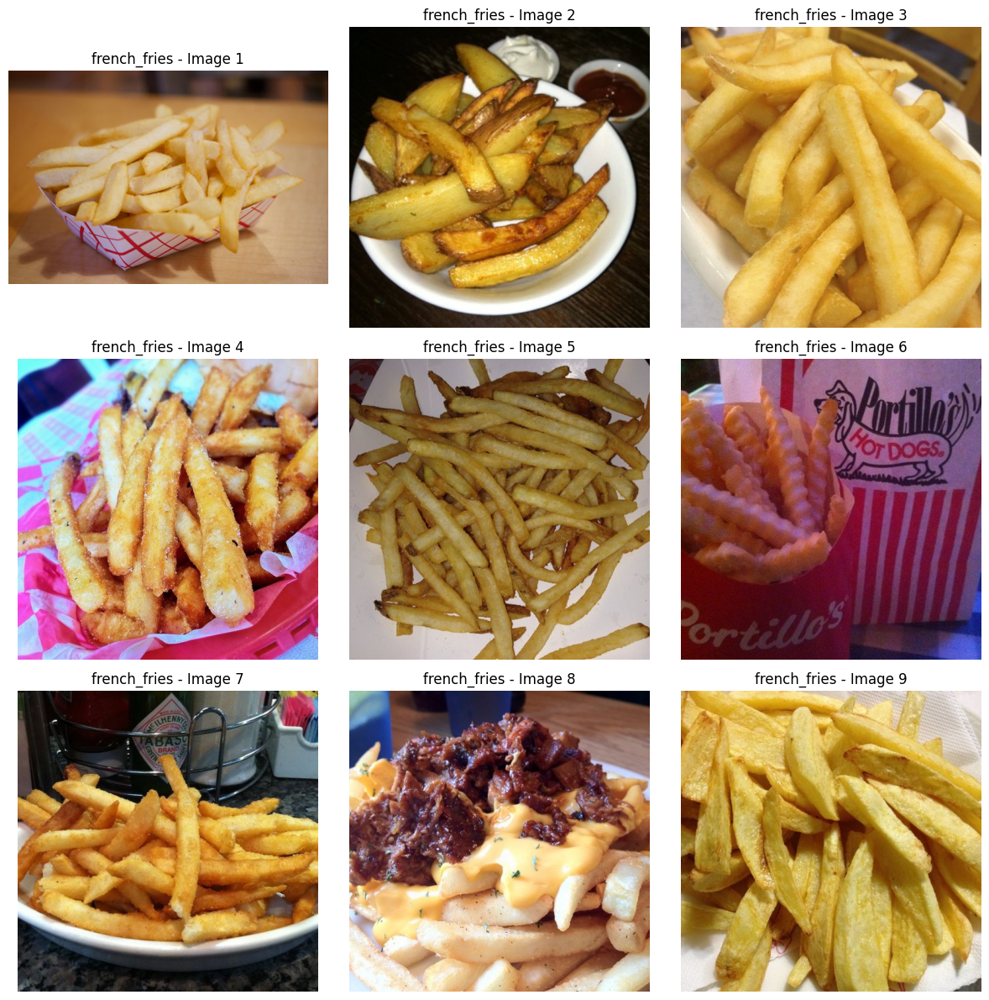

In [122]:
display_random_images(dataset_dir, 'french_fries', num_images=9)

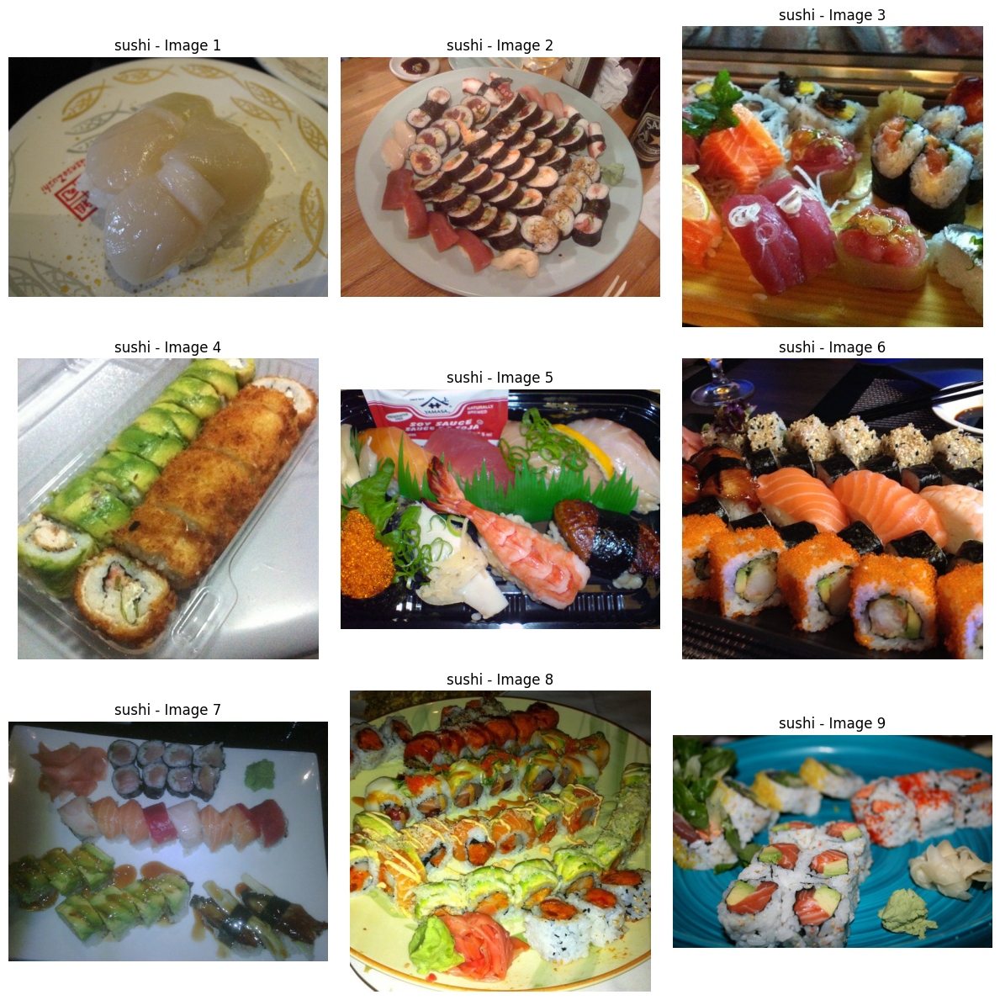

In [123]:
display_random_images(dataset_dir, 'sushi', num_images=9)

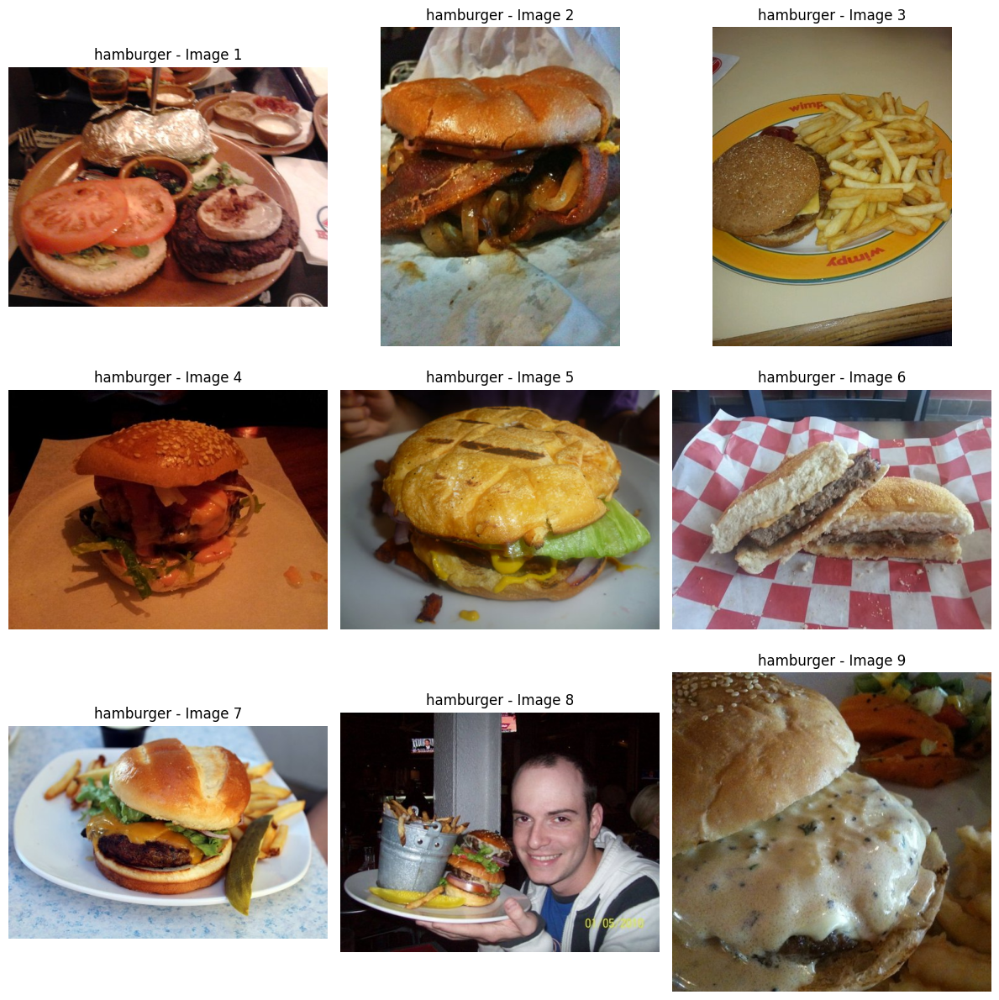

In [124]:
display_random_images(dataset_dir, 'hamburger', num_images=9)

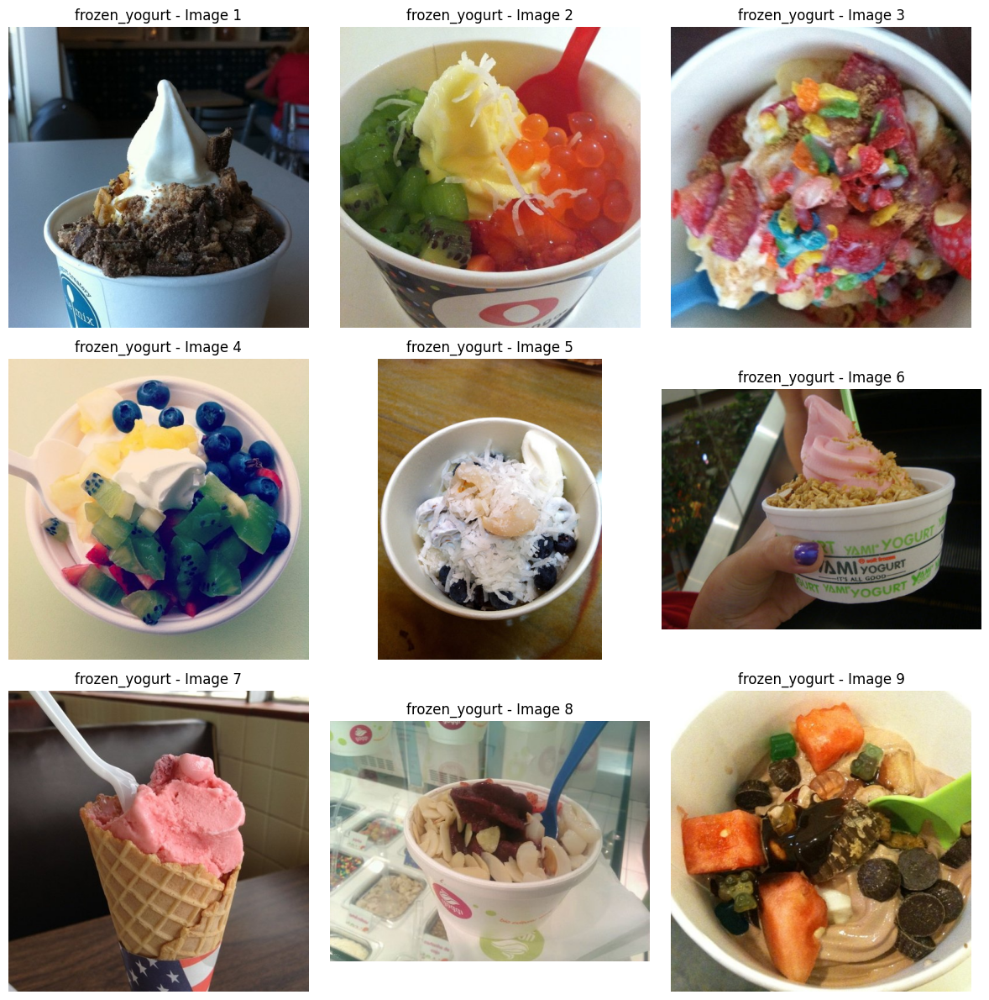

In [5]:
display_random_images(data_dir, 'frozen_yogurt', num_images=9)

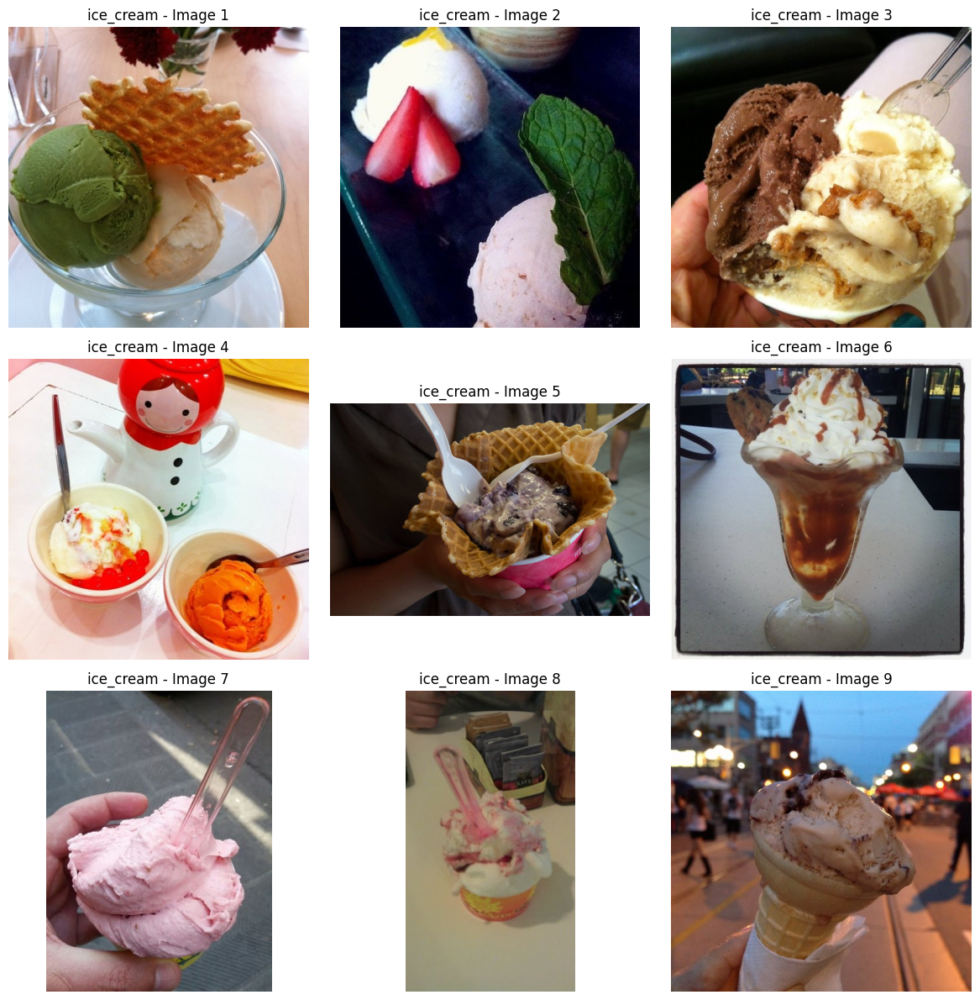

In [15]:
display_random_images(data_dir, 'ice_cream', num_images=9)

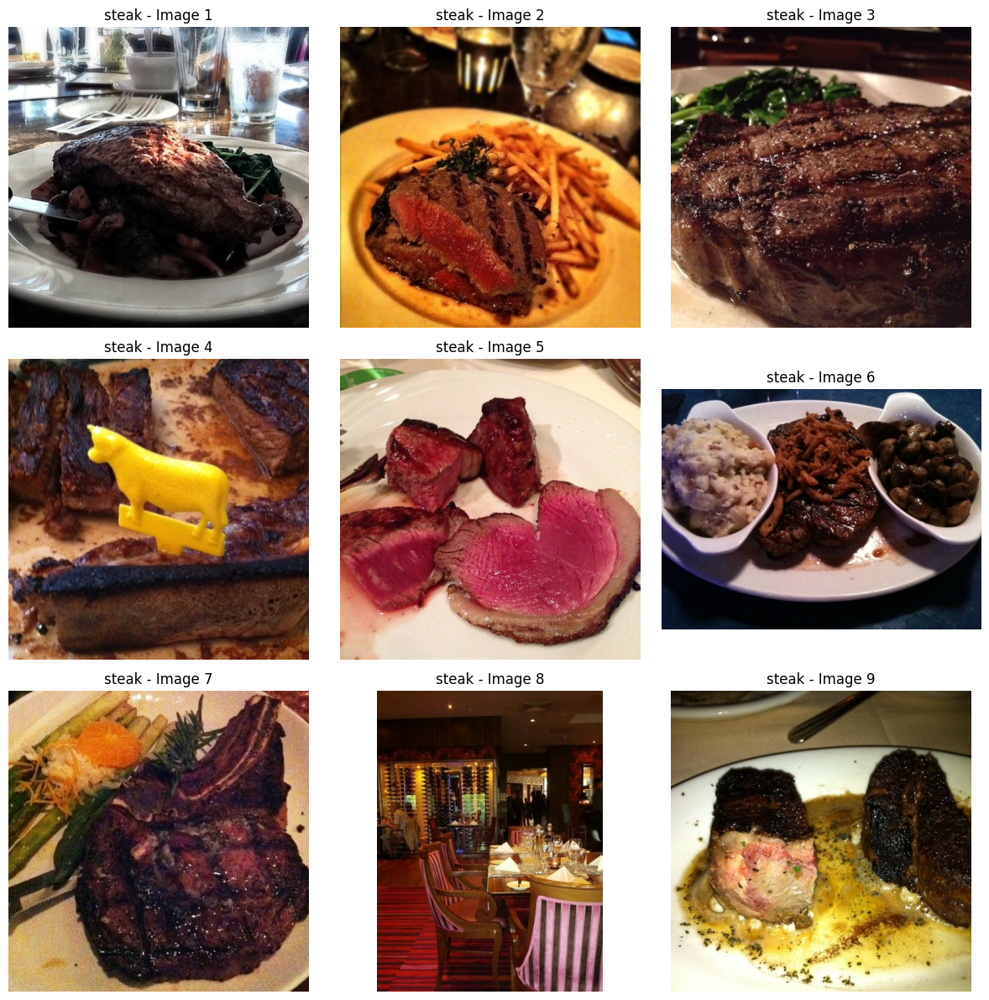

In [16]:
display_random_images(data_dir, 'steak', num_images=9)

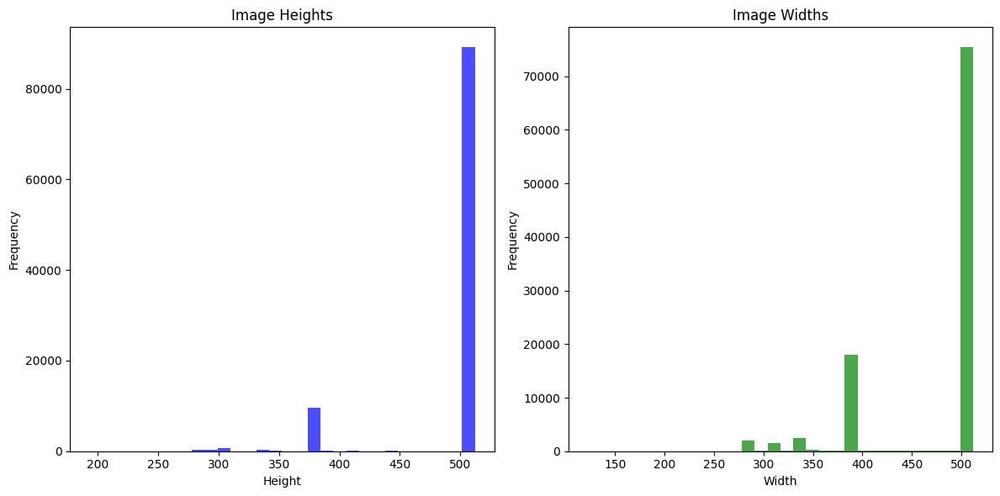

In [7]:
def get_image_dimensions(image_path):
    with Image.open(image_path) as img:
        return img.size

def display_dimensions_histogram(dataset_path):
    image_dimensions = []

    # Iterate through all image files in the dataset
    for root, dirs, files in os.walk(dataset_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                image_path = os.path.join(root, file)
                dimensions = get_image_dimensions(image_path)
                image_dimensions.append(dimensions)

    # Unzip the dimensions into separate lists for height and width
    heights, widths = zip(*image_dimensions)

    # Create histograms for height and width
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.hist(heights, bins=30, color='blue', alpha=0.7)
    plt.title('Image Heights')
    plt.xlabel('Height')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(widths, bins=30, color='green', alpha=0.7)
    plt.title('Image Widths')
    plt.xlabel('Width')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()


display_dimensions_histogram(data_dir)

In [3]:
batch_size = 96
img_height = 512
img_width = 512

In [4]:

train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 101000 files belonging to 101 classes.
Using 80800 files for training.


In [5]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 101000 files belonging to 101 classes.
Using 20200 files for validation.


In [13]:
class_names = train_ds.class_names
print(class_names)

['apple_pie', 'baby_back_ribs', 'baklava', 'beef_carpaccio', 'beef_tartare', 'beet_salad', 'beignets', 'bibimbap', 'bread_pudding', 'breakfast_burrito', 'bruschetta', 'caesar_salad', 'cannoli', 'caprese_salad', 'carrot_cake', 'ceviche', 'cheese_plate', 'cheesecake', 'chicken_curry', 'chicken_quesadilla', 'chicken_wings', 'chocolate_cake', 'chocolate_mousse', 'churros', 'clam_chowder', 'club_sandwich', 'crab_cakes', 'creme_brulee', 'croque_madame', 'cup_cakes', 'deviled_eggs', 'donuts', 'dumplings', 'edamame', 'eggs_benedict', 'escargots', 'falafel', 'filet_mignon', 'fish_and_chips', 'foie_gras', 'french_fries', 'french_onion_soup', 'french_toast', 'fried_calamari', 'fried_rice', 'frozen_yogurt', 'garlic_bread', 'gnocchi', 'greek_salad', 'grilled_cheese_sandwich', 'grilled_salmon', 'guacamole', 'gyoza', 'hamburger', 'hot_and_sour_soup', 'hot_dog', 'huevos_rancheros', 'hummus', 'ice_cream', 'lasagna', 'lobster_bisque', 'lobster_roll_sandwich', 'macaroni_and_cheese', 'macarons', 'miso_sou

2024-02-06 12:29:59.128865: W tensorflow/core/kernels/data/prefetch_autotuner.cc:52] Prefetch autotuner tried to allocate 301990272 bytes after encountering the first element of size 301990272 bytes.This already causes the autotune ram budget to be exceeded. To stay within the ram budget, either increase the ram budget or reduce element size
2024-02-06 12:29:59.129282: W tensorflow/core/kernels/data/prefetch_autotuner.cc:52] Prefetch autotuner tried to allocate 301990272 bytes after encountering the first element of size 301990272 bytes.This already causes the autotune ram budget to be exceeded. To stay within the ram budget, either increase the ram budget or reduce element size


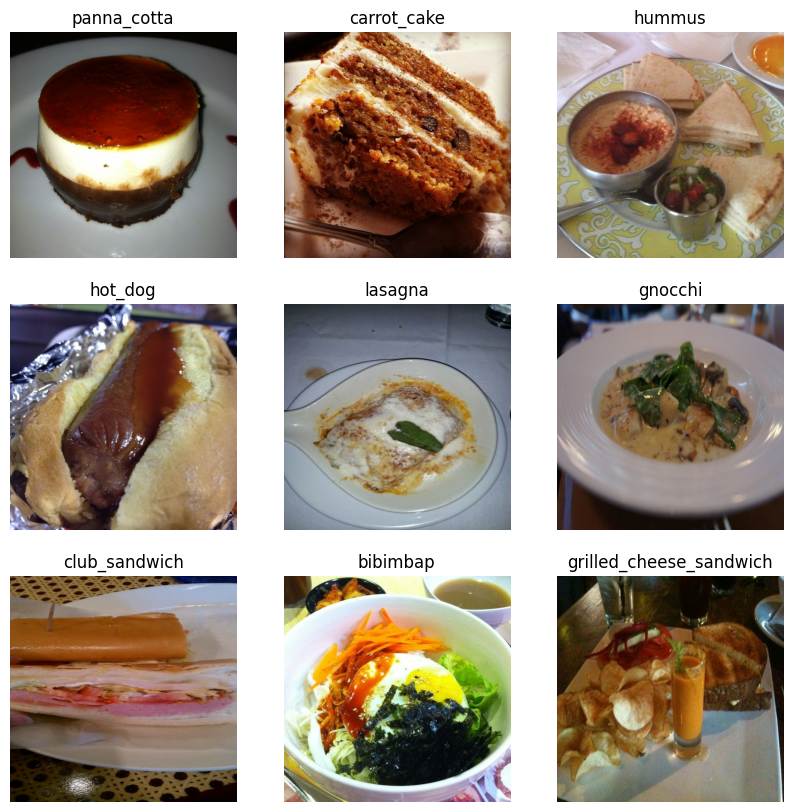

In [14]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")